In [2]:
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image

from rec.utils import draw_bounding_boxes

In [6]:
BASE_PATH = "../code/rec/"

### Read validation data

In [4]:
df_valid_results = pd.read_parquet("../models/exp_004/predictions_val.parquet")

In [5]:
df_valid_results.head()

,bbox_raw,bbox_pred,img_filename,expr,hits,spatial,ordinal,relational,intrinsic
0,"[156.0, 169.0, 224.0, 360.0]","[49.481747, 99.540726, 301.4215, 272.09885]",refer/data/images/saiapr_tc-12/10/images/10890...,person on the left,0.0,1,0,0,0
1,"[0.0, 94.0, 480.0, 360.0]","[62.72489, 94.11238, 340.92255, 246.16074]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,the trees,0.0,0,0,0,1
2,"[110.0, 64.0, 296.0, 183.0]","[65.14025, 65.82784, 359.55045, 232.00388]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,sky next to clouds,0.0,1,0,1,0
3,"[201.0, 49.0, 331.0, 184.0]","[60.592358, 81.93651, 333.8043, 234.55069]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,clouds,0.0,0,0,0,1
4,"[176.0, 56.0, 478.0, 195.0]","[64.9345, 103.80368, 327.54202, 251.31976]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,mountain,0.0,0,0,0,1


SPATIAL
SPATIAL, HITS=1
the sky with no clouds


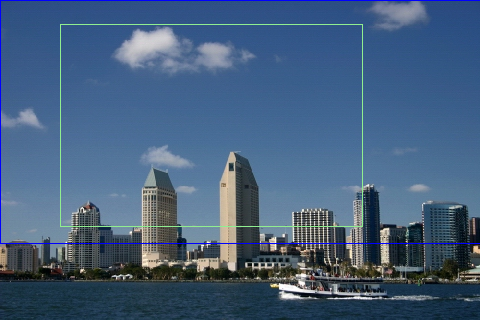

SPATIAL, HITS=1
dirt at bottom


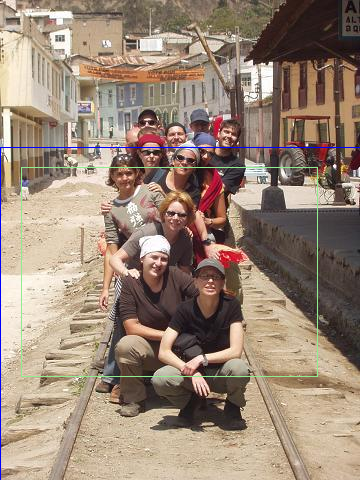

SPATIAL, HITS=1
top bunk


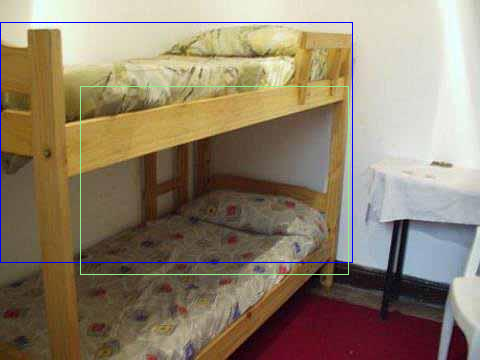

SPATIAL, HITS=1
sandy bottom area


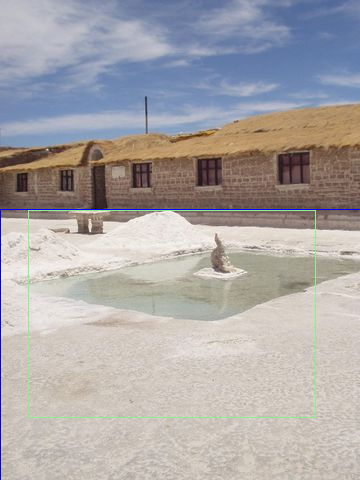

SPATIAL, HITS=1
lady with white bra top


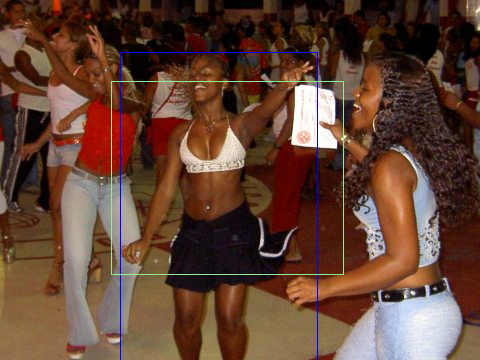

SPATIAL, HITS=1
lit up buildings on left side middle


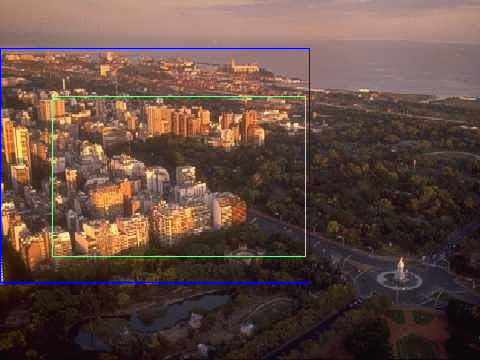

SPATIAL, HITS=1
whitewater down the center of the falls


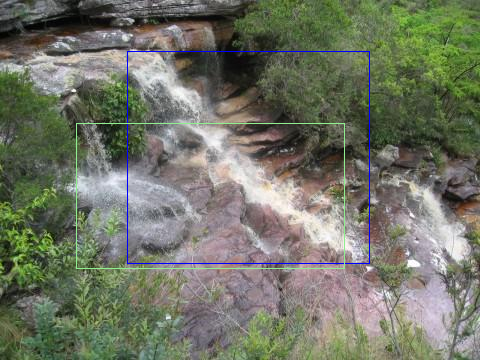

SPATIAL, HITS=1
woman bancing in black skirt


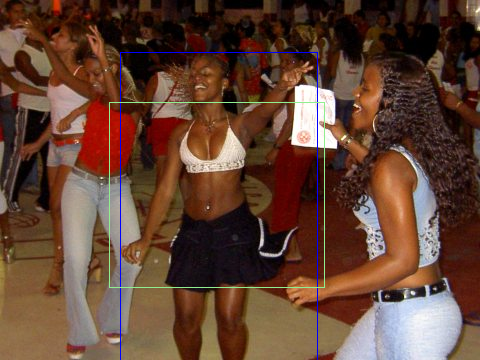

SPATIAL, HITS=1
woman dancing in middle


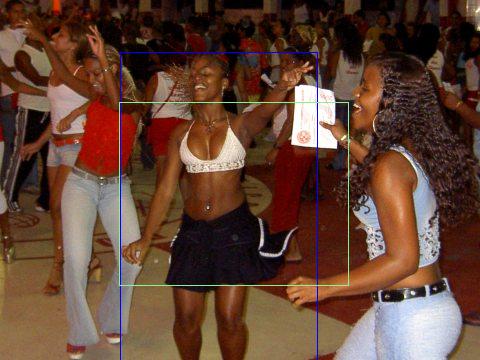

SPATIAL, HITS=1
the clouds in the center


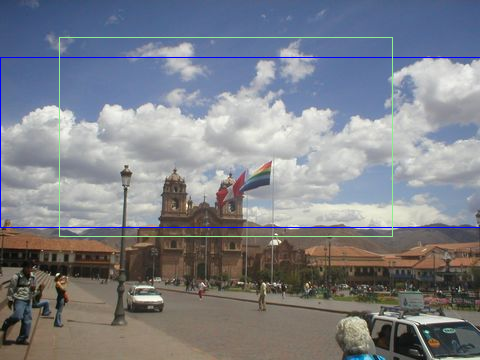

ORDINAL
ORDINAL, HITS=1
first skeleton in front


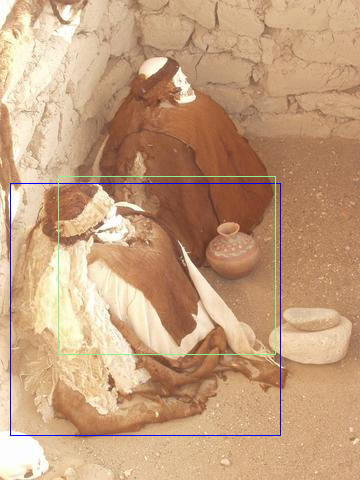

ORDINAL, HITS=1
first car on the right


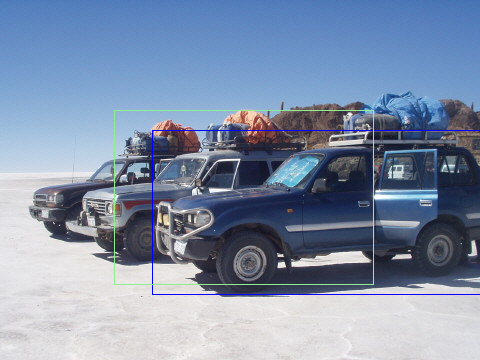

RELATIONAL
RELATIONAL, HITS=1
city line with clouds in the sky


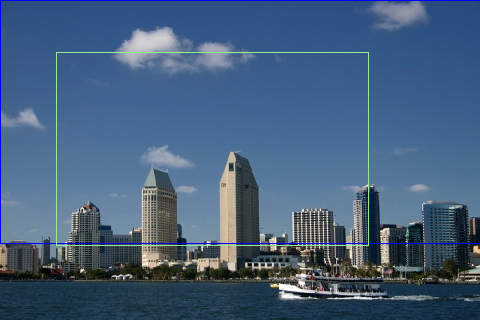

RELATIONAL, HITS=1
person in black skirt


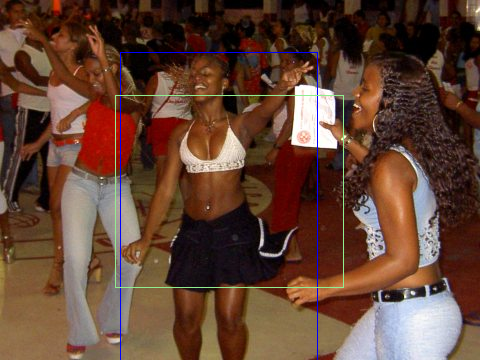

RELATIONAL, HITS=1
woman bancing in black skirt


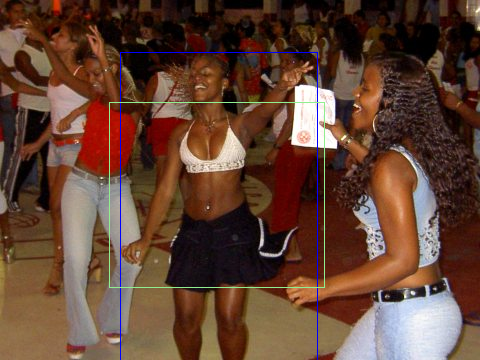

RELATIONAL, HITS=1
wood wall between mattresses


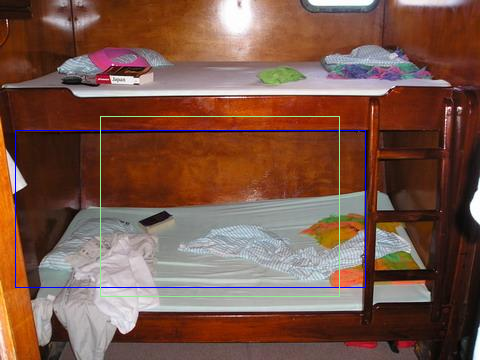

RELATIONAL, HITS=1
woman in black t-shirt


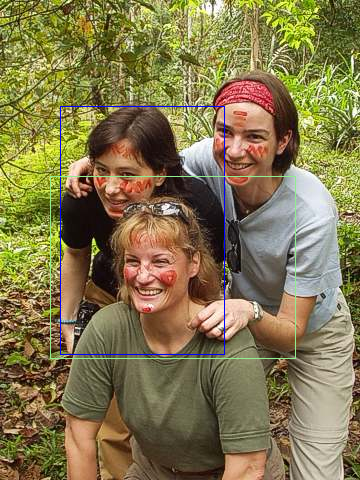

RELATIONAL, HITS=1
stones on left behind guy in blue


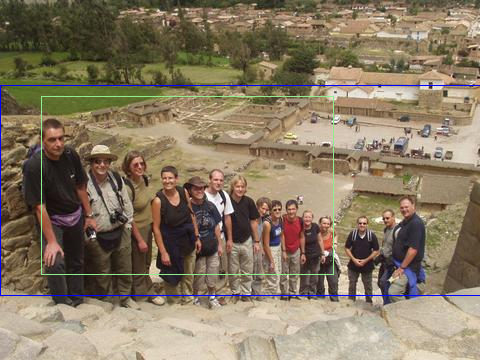

RELATIONAL, HITS=1
grassy area above branch


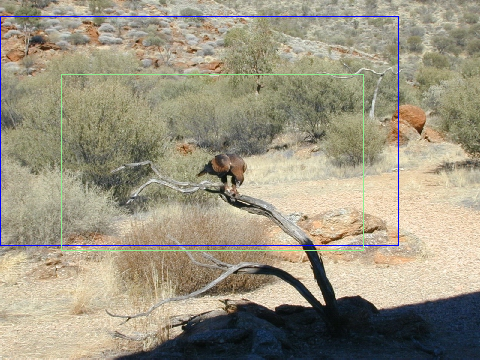

RELATIONAL, HITS=1
girl in bikini top


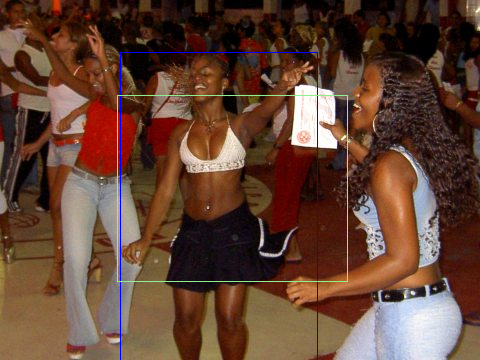

RELATIONAL, HITS=1
the water to the right of the lighthouse


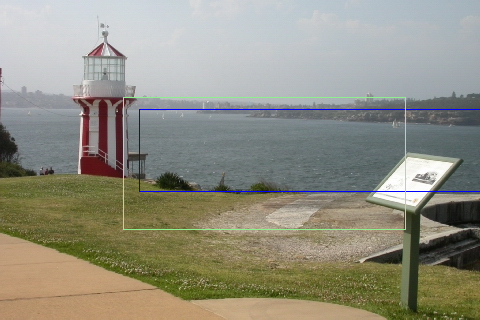

RELATIONAL, HITS=1
the city lit by sunlight


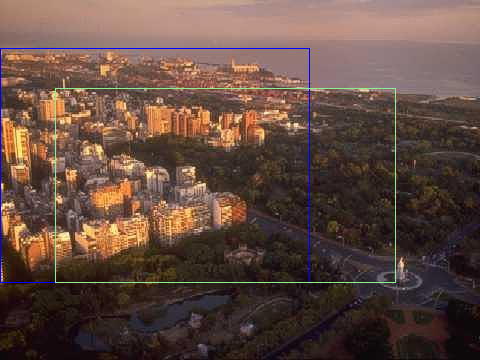

INTRINSIC
INTRINSIC, HITS=1
statue


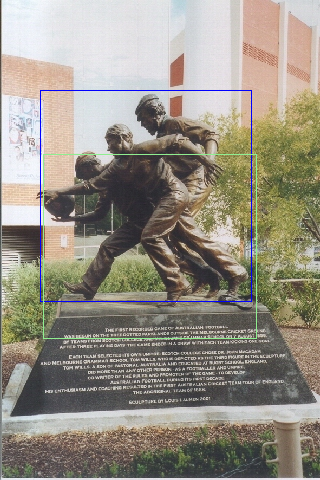

INTRINSIC, HITS=1
kids fave


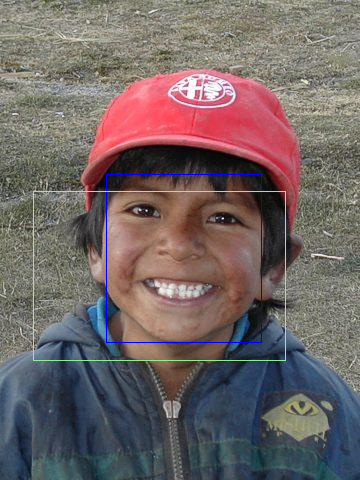

INTRINSIC, HITS=1
menu


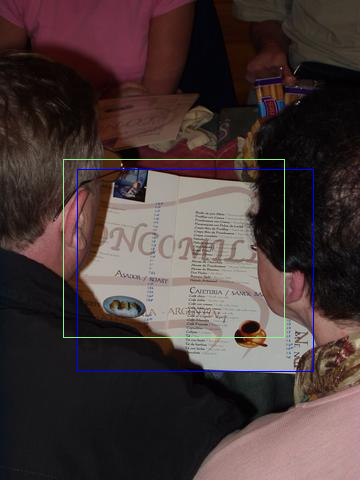

INTRINSIC, HITS=1
people


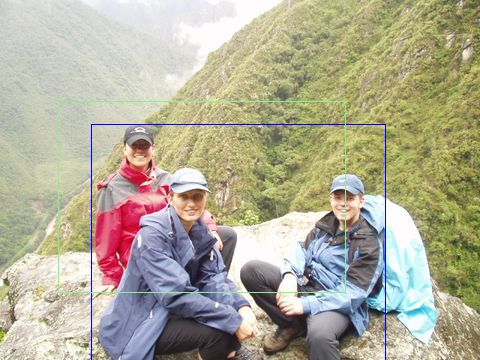

INTRINSIC, HITS=1
white bra girl


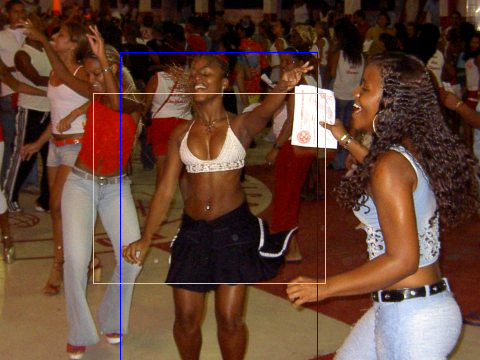

INTRINSIC, HITS=1
bed


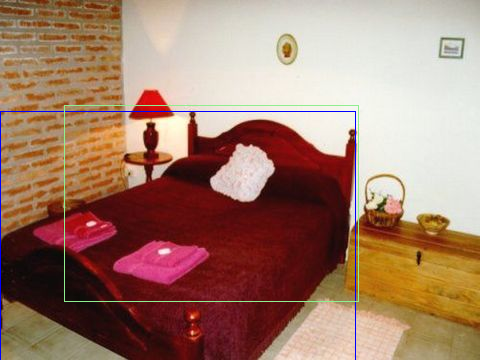

INTRINSIC, HITS=1
bird


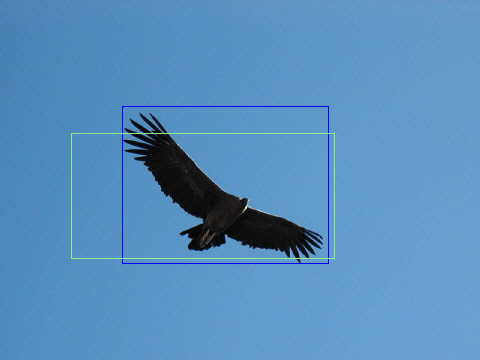

INTRINSIC, HITS=1
roof


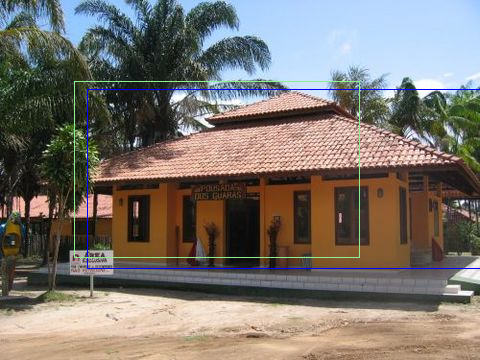

INTRINSIC, HITS=1
people


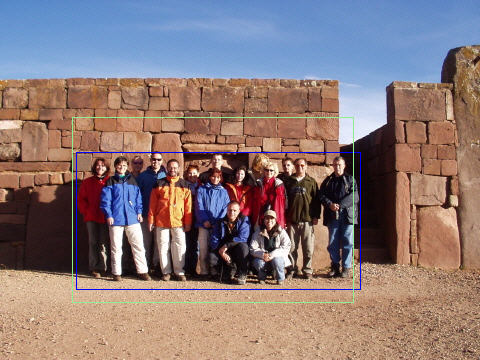

INTRINSIC, HITS=1
sky


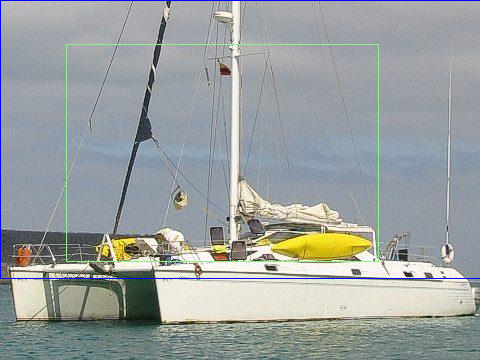

In [55]:
for rec_cls in ["spatial", "ordinal", "relational", "intrinsic"]:
    mask_counts = df_valid_results[rec_cls] == 1
    mask_hits = df_valid_results["hits"] == 1
    size_rec_cls_hits = df_valid_results[mask_counts & mask_hits].shape[0]
    df_sample_cls = (
        df_valid_results[mask_counts & mask_hits].sample(
            min(10, size_rec_cls_hits), random_state=42
        )
    )
    for _, row in df_sample_cls.loc[:, ["bbox_raw", "bbox_pred", "img_filename", "expr"]].iterrows():
        im = Image.open(f"{BASE_PATH}{row['img_filename']}")
        im = draw_bounding_boxes(im, [row['bbox_raw']], fmt="xyxy", color="blue")
        im = draw_bounding_boxes(im, [row['bbox_pred']], fmt="xyxy", color="lightgreen")
        print(f"{rec_cls.upper()}, HITS=1")
        print(row['expr'])
        im.show()

SPATIAL, HITS=0
man on the left facing camera


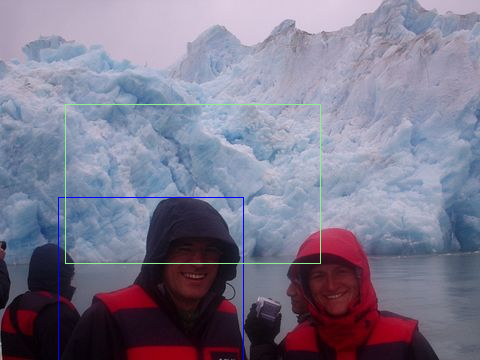

SPATIAL, HITS=0
second water bottle from top left shelf


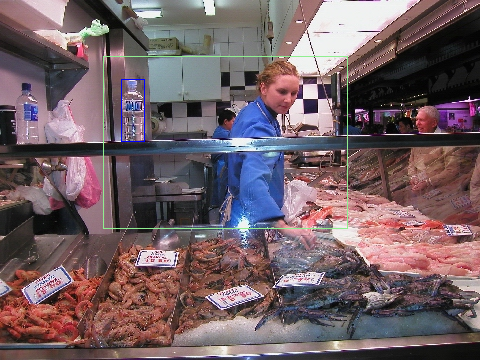

SPATIAL, HITS=0
right , bottom , not people


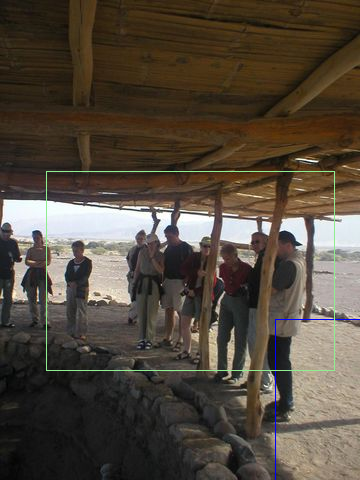

SPATIAL, HITS=0
top of pic


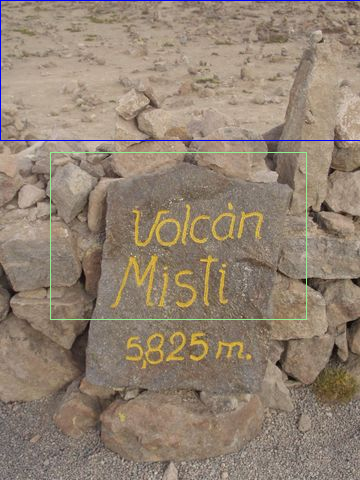

SPATIAL, HITS=0
top book shelf second in from the left


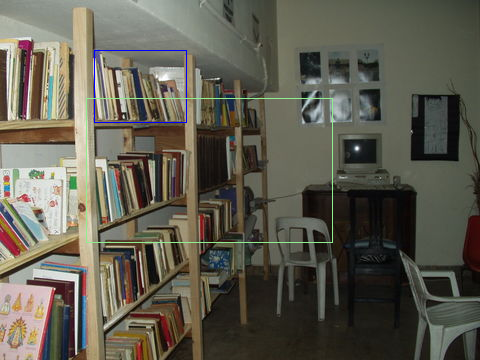

SPATIAL, HITS=0
water on right of girls hair


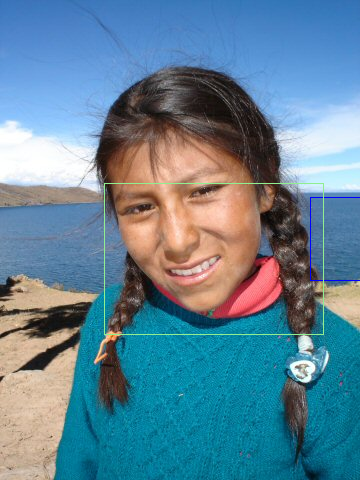

SPATIAL, HITS=0
the grass on the direct right side of the picture


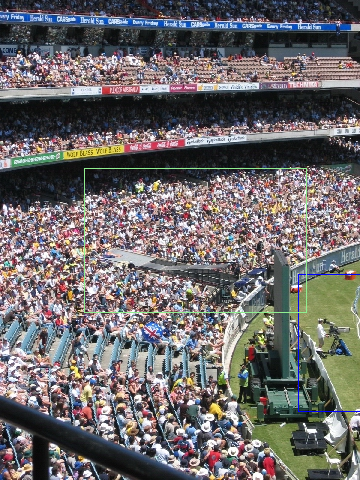

SPATIAL, HITS=0
bottom half of city


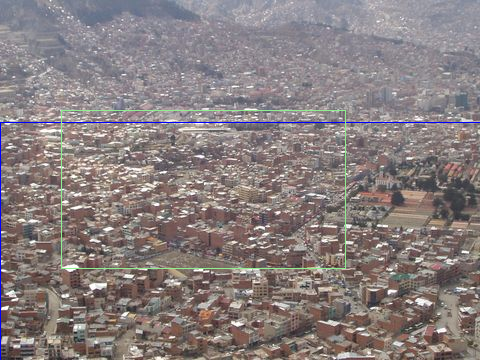

SPATIAL, HITS=0
no image on the last one , sorry , panda


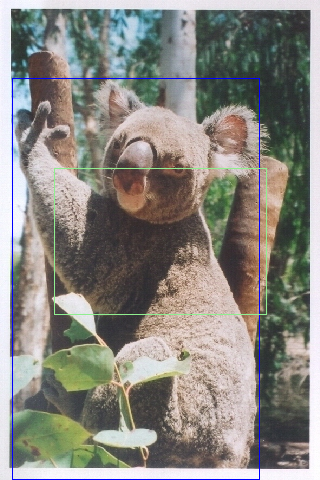

SPATIAL, HITS=0
tree to the left of the cross


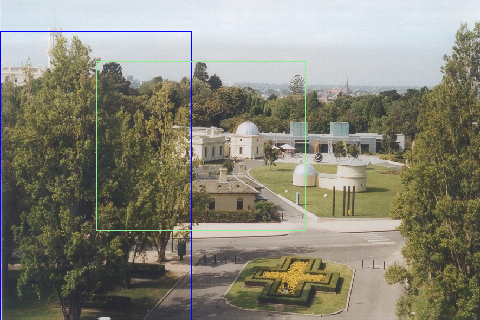

ORDINAL, HITS=0
first row on right with 4 pictures in the row


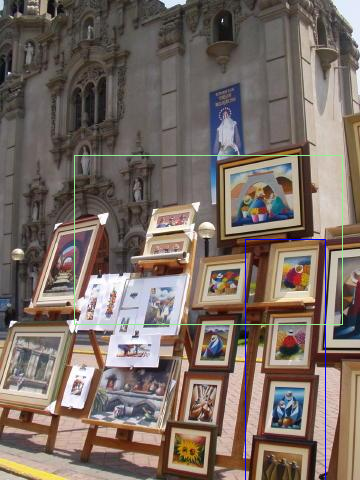

ORDINAL, HITS=0
second man


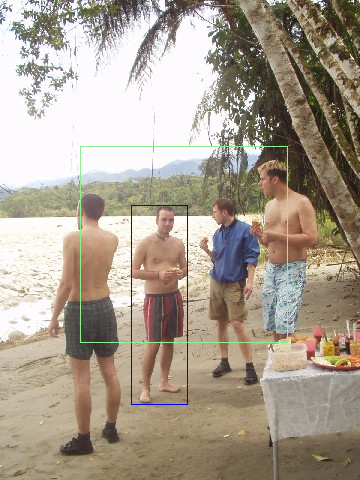

ORDINAL, HITS=0
sorry could n't see first pic , any of the people on right , woman in reddish shirt , man next to her in white


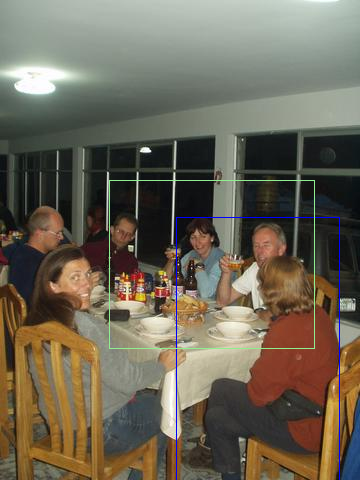

ORDINAL, HITS=0
people above the third bench


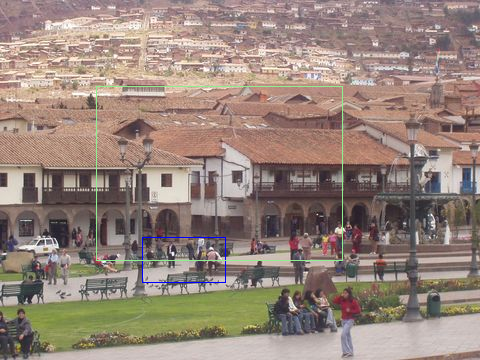

ORDINAL, HITS=0
you had it , car right side first one


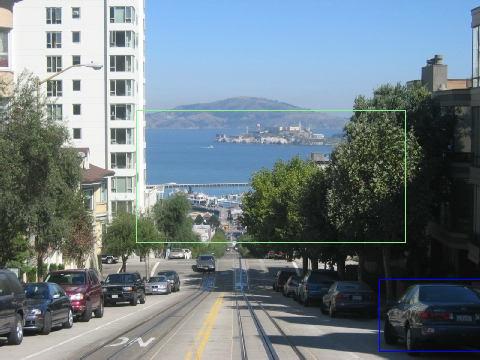

ORDINAL, HITS=0
2nd row of books from the ground in the front has black books


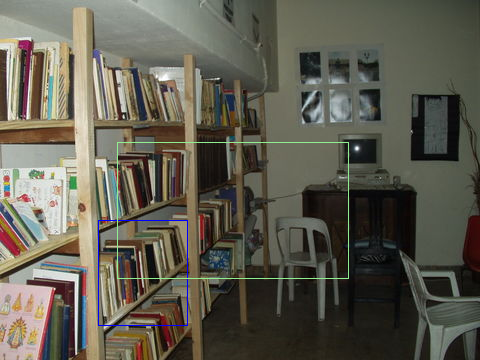

ORDINAL, HITS=0
2nd person on left a lady


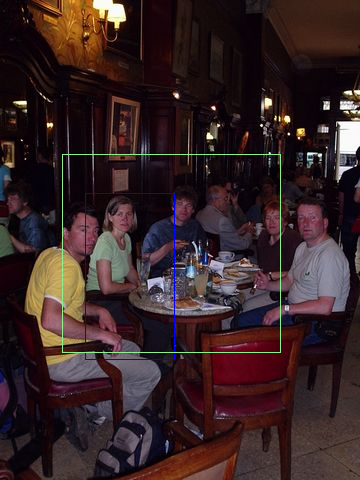

ORDINAL, HITS=0
second bottle on left


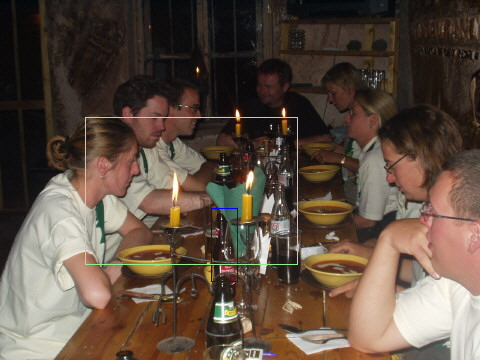

ORDINAL, HITS=0
second man from left


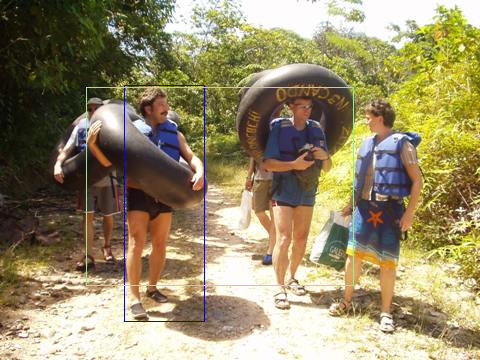

ORDINAL, HITS=0
full row of books , 2nd row up from bottom first full row


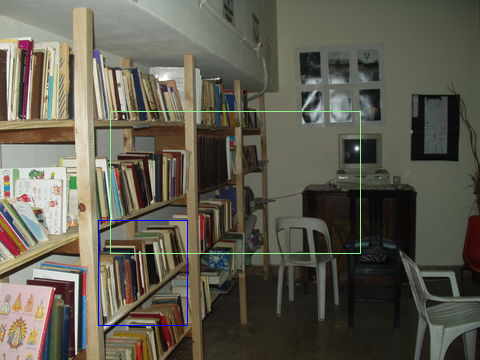

RELATIONAL, HITS=0
lightspace out windows


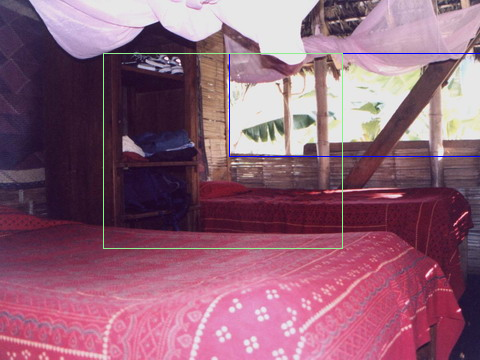

RELATIONAL, HITS=0
person sitting in the middle with the big hat on


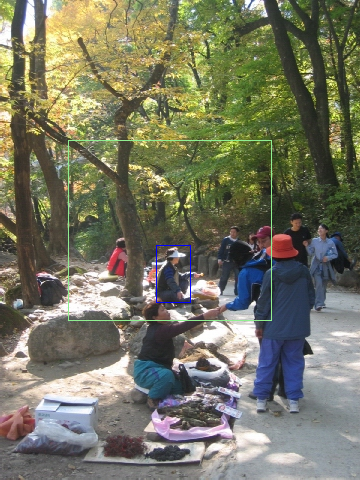

RELATIONAL, HITS=0
dirt pile above right sign


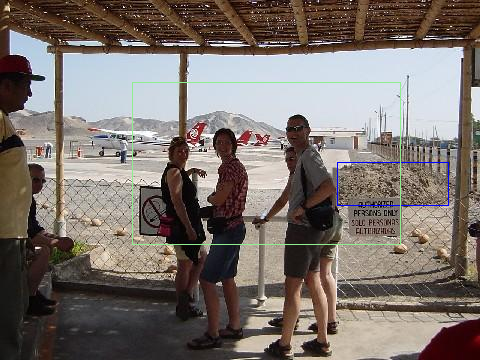

RELATIONAL, HITS=0
area of land bottom left


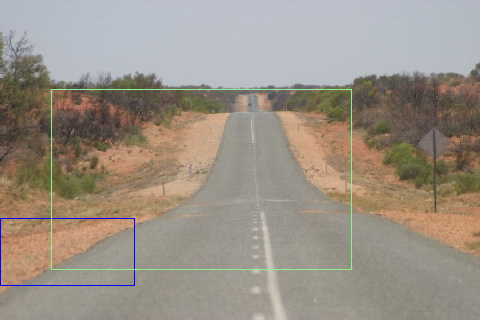

RELATIONAL, HITS=0
blonde girl 's face on right , in black hat


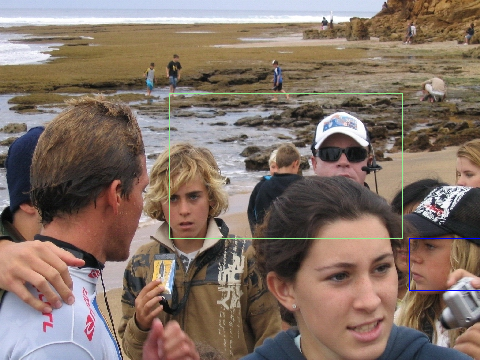

RELATIONAL, HITS=0
sidewalk right of green car


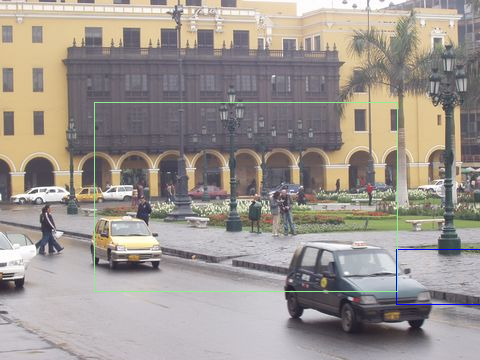

RELATIONAL, HITS=0
middle tree beside beige building


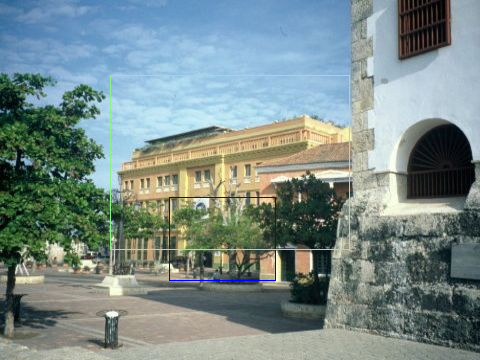

RELATIONAL, HITS=0
picture on wall


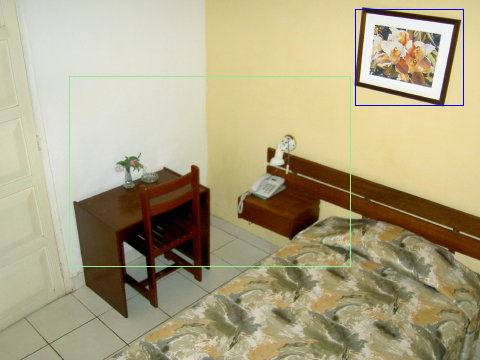

RELATIONAL, HITS=0
the rock to the right of the boy , the one you can see the whole thing


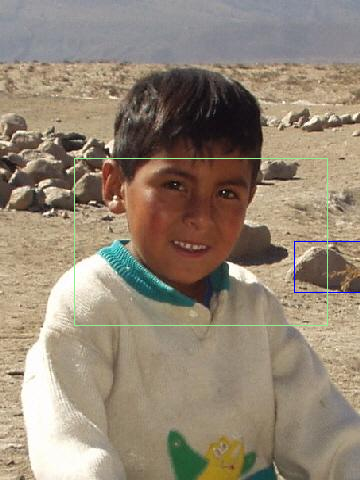

RELATIONAL, HITS=0
left horse with rider


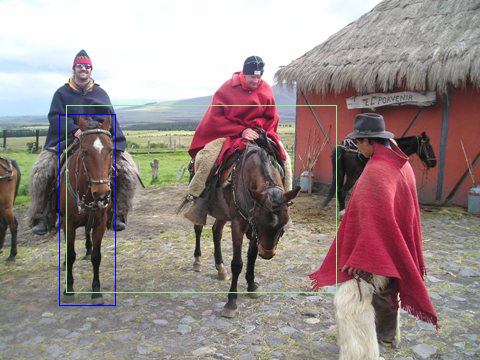

INTRINSIC, HITS=0
fountain


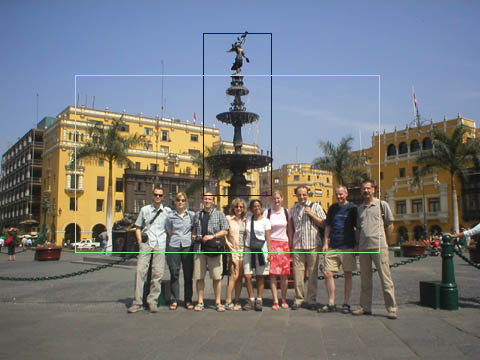

INTRINSIC, HITS=0
the window


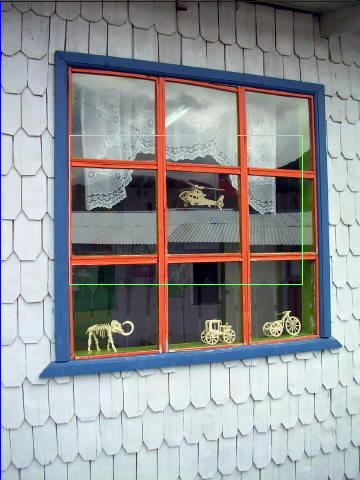

INTRINSIC, HITS=0
the sand


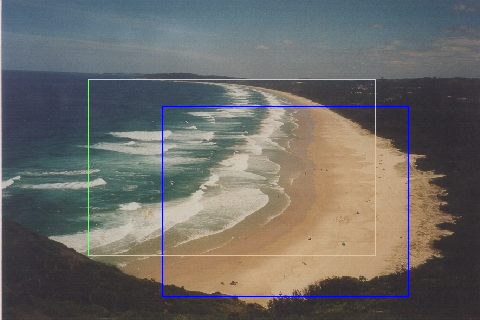

INTRINSIC, HITS=0
sky


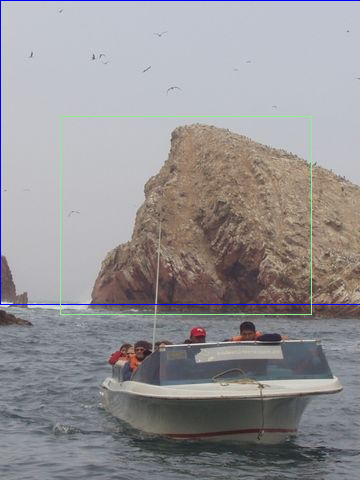

INTRINSIC, HITS=0
man


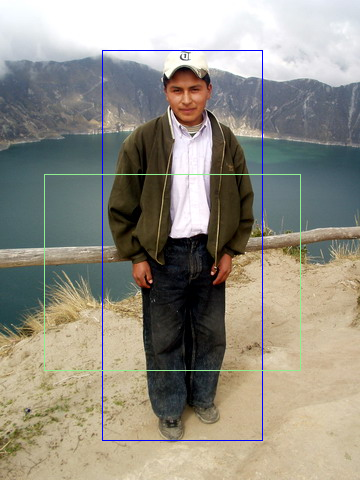

INTRINSIC, HITS=0
kid


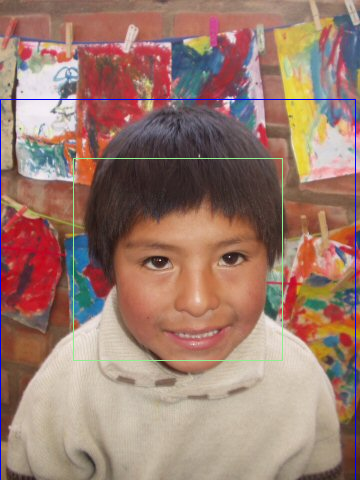

INTRINSIC, HITS=0
traincar ceiling


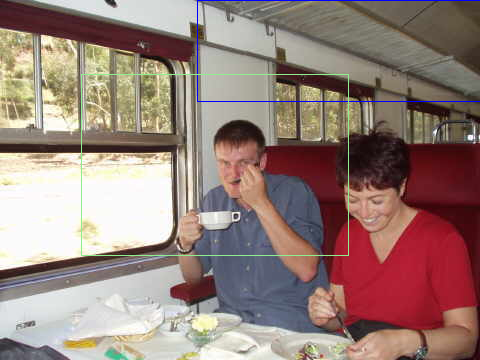

INTRINSIC, HITS=0
mountain


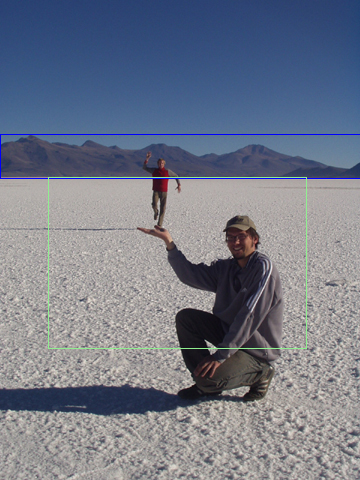

INTRINSIC, HITS=0
ruins


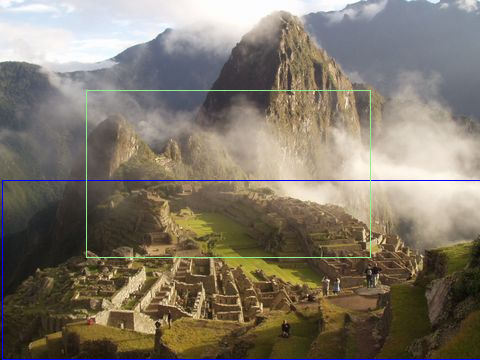

INTRINSIC, HITS=0
chair


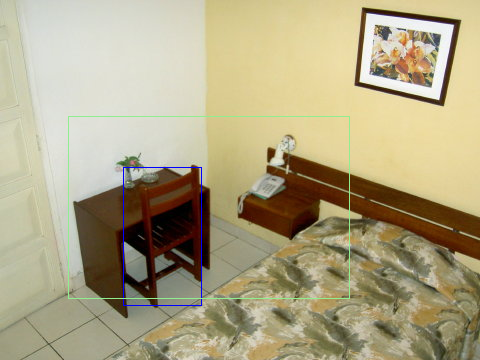

In [56]:
for rec_cls in ["spatial", "ordinal", "relational", "intrinsic"]:
    mask_counts = df_valid_results[rec_cls] == 1
    mask_hits = df_valid_results["hits"] == 0
    size_rec_cls_hits = df_valid_results[mask_counts & mask_hits].shape[0]
    df_sample_cls = (
        df_valid_results[mask_counts & mask_hits].sample(
            min(10, size_rec_cls_hits), random_state=42
        )
    )
    for _, row in df_sample_cls.loc[:, ["bbox_raw", "bbox_pred", "img_filename", "expr"]].iterrows():
        im = Image.open(f"{BASE_PATH}{row['img_filename']}")
        im = draw_bounding_boxes(im, [row['bbox_raw']], fmt="xyxy", color="blue")
        im = draw_bounding_boxes(im, [row['bbox_pred']], fmt="xyxy", color="lightgreen")
        print(f"{rec_cls.upper()}, HITS=0")
        print(row['expr'])
        im.show()